# clean tide gauge data

In [6]:
import os
from glob import glob

import numpy as np
import pandas as pd
import xarray as xr

%matplotlib inline
import matplotlib.pyplot as plt
import hvplot.xarray  # noqa
import hvplot.pandas  # noqa

import pynsitu as pin

crs = pin.maps.crs

# drixmed utils
import utils as ut

In [89]:
root_dir = "/Users/aponte/Cloud/Ifremer/drixmed22"
campaign = "drixmed22"
yaml = f"python/{campaign}.yaml"

cp = pin.campaign(os.path.join(root_dir, yaml))

kwargs_map = dict(extent=cp.lon + cp.lat, bathy=cp.bathy["label"])

underway
tide_gauge
adcp_europe
adcp_drix
ctd_europe
ctd_drix
0-4350125
0-4352044
0-4350124
0-4352185
0-4351896
0-4352181


---

## load data

In [64]:
def load_tide_gauge(cp, tgauge_id):
    """Load tide gauge data (RBR duet)

    Parameters
    ----------
    cp: pynsitu.events.campaign
        Campaign object
    tgauge_id: str
    """

    # browse file tree
    paths = sorted(glob(os.path.join(cp.pathr, "MAREGRAPHE/*")))
    dirs = [p for p in paths if tgauge_id in p and os.path.isdir(p)]

    files = []
    for d in dirs:
        files = files + glob(os.path.join(d, "*_data.txt"))
    files = sorted(files)

    # read csv and concatenate
    df = pd.concat([pd.read_csv(f, index_col=0, parse_dates=True) for f in files])

    return df.to_xarray().rename(Time="time")

In [65]:
tg_ids = ["082218", "200470"]
T = {tg: load_tide_gauge(cp, tg) for tg in tg_ids}

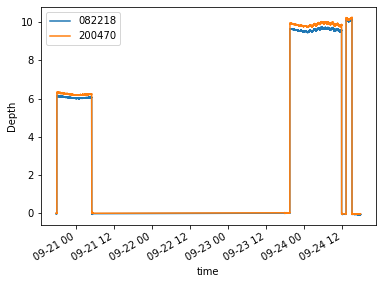

In [66]:
for tg, ds in T.items():
    ds.Depth.plot(label=tg)
plt.legend()

with hvplot ...

In [57]:
T["082218"].Depth.hvplot(label="082218") * T["200470"].Depth.hvplot(label="200470")

:Overlay
   .Curve.A_082218 :Curve   [Time]   (Depth)
   .Curve.A_200470 :Curve   [Time]   (Depth)

---
### split into deployments and store

In [74]:
Tc = {}
for d in cp["tide_gauge"]:
    for tg, ds in T.items():
        dsd = ds.sel(time=slice(d.start.time, d.end.time))
        nc = os.path.join(cp.pathp, f"tide_gauge_{d.label}_{tg}.nc")
        dsd.to_netcdf(nc, mode="w")

### reload and plot

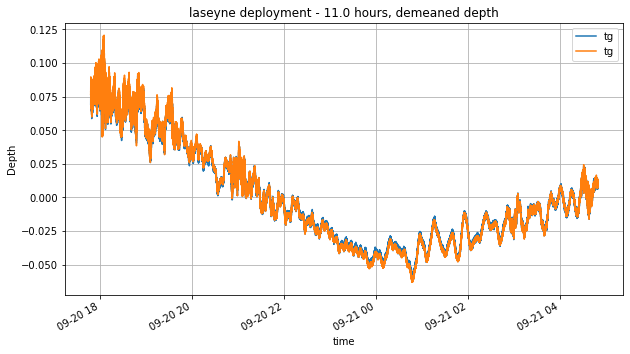

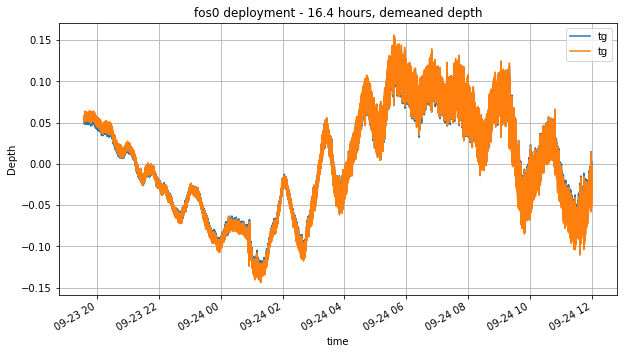

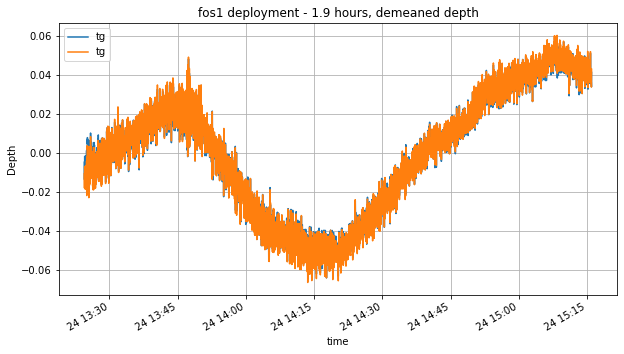

In [87]:
for d in cp["tide_gauge"]:
    fig, ax = plt.subplots(1, 1, figsize=(10, 5))
    for tg in tg_ids:
        nc = os.path.join(cp.pathp, f"tide_gauge_{d.label}_{tg}.nc")
        ds = xr.open_dataset(nc)
        da = ds.Depth - ds.Depth.mean()
        da.plot(ax=ax, label="tg")
    dt = (ds.time[-1] - ds.time[0]).values / pd.Timedelta("1H")
    ax.set_title(f"{d.label} deployment - {dt:.1f} hours, demeaned depth [m]")
    ax.legend()
    ax.grid()

Same with 1 minute averaging

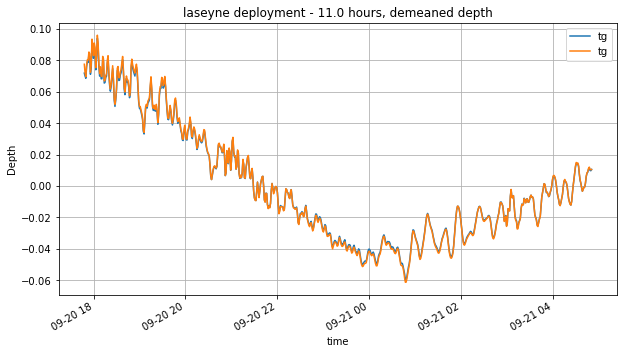

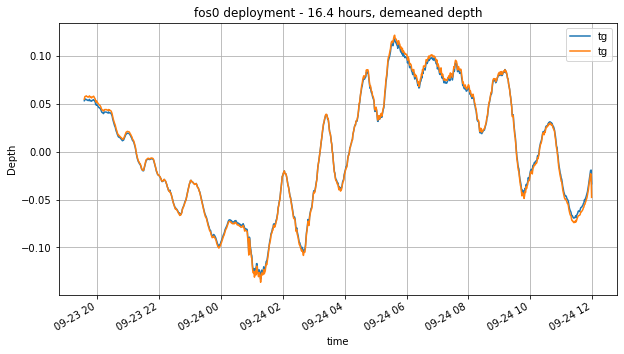

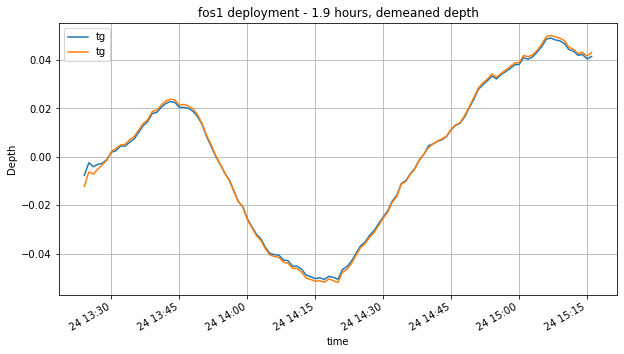

In [88]:
for d in cp["tide_gauge"]:
    fig, ax = plt.subplots(1, 1, figsize=(10, 5))
    for tg in tg_ids:
        nc = os.path.join(cp.pathp, f"tide_gauge_{d.label}_{tg}.nc")
        ds = xr.open_dataset(nc)
        da = ds.Depth - ds.Depth.mean()
        da = da.resample(dict(time="1T")).mean()
        da.plot(ax=ax, label="tg")
    dt = (ds.time[-1] - ds.time[0]).values / pd.Timedelta("1H")
    ax.set_title(f"{d.label} deployment - {dt:.1f} hours, demeaned depth [m]")
    ax.legend()
    ax.grid()